#### Part 1 : Generating the Noisy Images using Inbuilt and Custom Functions

Importing the Libraries

In [1]:
import numpy as np
import cv2
import matplotlib.pyplot as plt
import os
from scipy.ndimage import convolve1d
import pandas as pd
from skimage.metrics import peak_signal_noise_ratio
from skimage.restoration import denoise_tv_chambolle

Functions to add noise to the image

In [2]:
# add gaussian noise to image using inbuilt functions
def gaussian_noise_cv2(image, mean, std_dev):
    noise = np.random.normal(mean, std_dev, image.shape).astype(np.uint8)
    noisy_image = cv2.add(image, noise)
    return noisy_image

# add defocus blur to image using inbuilt functions
def defocus_blur_cv2(image, kernel_size):
    if kernel_size % 2 == 0: kernel_size += 1
    kernel = np.ones((kernel_size, kernel_size), dtype=np.float32) / (kernel_size ** 2)
    blurred_image = cv2.filter2D(image, -1, kernel)
    return blurred_image

# function for performing addition to image in 32 bit and then clipping to 8 bit
def mimic_cv2_add(image, value):
    result = image.astype(np.int32) + value
    result[result < 0] = 0
    result[result > 255] = 255
    return result.astype(np.uint8)

# add gaussian noise to image using custom functions
def gaussian_noise_custom(image, mean, std_dev):
    noise = np.random.normal(mean, std_dev, image.shape).astype(np.uint8)
    noisy_image = mimic_cv2_add(image, noise)
    return noisy_image

# add defocus blur to image using custom functions
def defocus_blur_custom(image, kernel_size):
    if kernel_size % 2 == 0: kernel_size += 1
    kernel = np.ones(kernel_size, dtype=np.float32) / kernel_size
    blurred_image = np.apply_along_axis(convolve1d, axis=1, arr=image, weights=kernel, mode='constant', cval=0.0)
    blurred_image = np.apply_along_axis(convolve1d, axis=0, arr=blurred_image, weights=kernel, mode='constant', cval=0.0)
    return blurred_image

In [3]:
def int2str(num):
    if num < 10: return '0' + str(num)
    else: return str(num)

# helper function to corrupt the images
def corrupt_images(image_folder, save_folder, noice_func, blur_func):
    images = os.listdir(image_folder)
    for _image in images:
        image = cv2.imread(os.path.join(image_folder, _image))
        noise_levels = [3, 5, 7, 9, 11] # standard deviation of gaussian noise
        blur_levels = [5, 11, 17, 23, 29] # kernel size for defocus blur

        for noise_level, blur_level in zip(noise_levels, blur_levels):
            blurred_image = blur_func(image, kernel_size=blur_level)
            noisy_image = noice_func(blurred_image, mean=0, std_dev=noise_level)
            image_name = _image.split('.')[0]
            image_name = image_name + '_noise_' + int2str(noise_level) + '_blur_' + int2str(blur_level) + '.png'
            plt.imsave(os.path.join(save_folder, image_name), cv2.cvtColor(noisy_image, cv2.COLOR_BGR2RGB))            

In [4]:
# corrupting the images using inbuilt functions
corrupt_images('Dataset', 'Corrupted_CV2', gaussian_noise_cv2, defocus_blur_cv2)

In [5]:
# corrupting the images using custom functions
corrupt_images('Dataset', 'Corrupted_Custom', gaussian_noise_custom, defocus_blur_custom)

#### Part 2 : Compairing the Noisy Images obtained from Inbuilt and Custom Functions

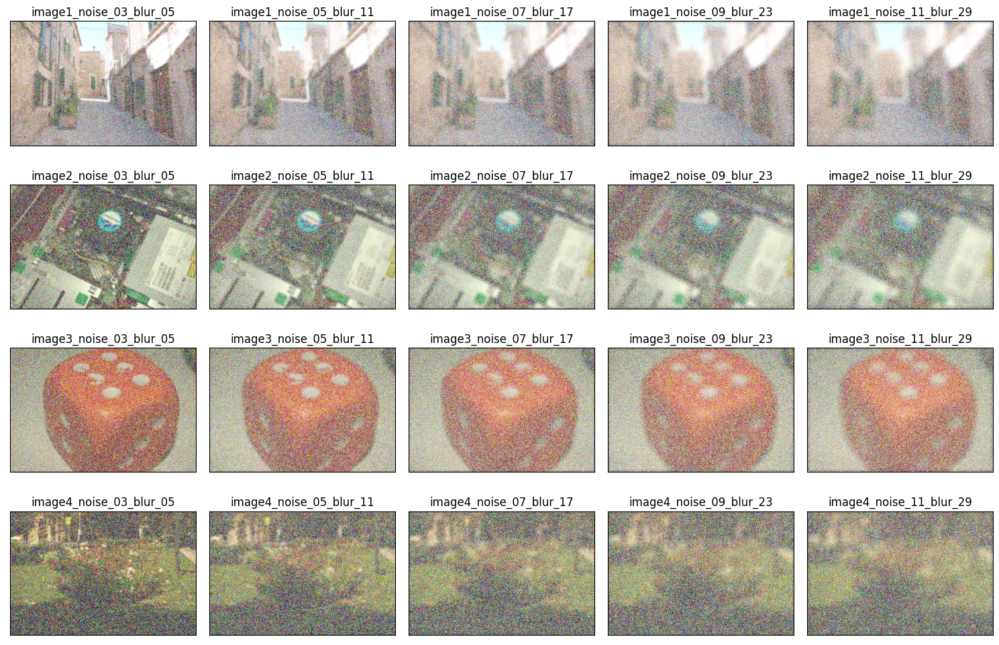

In [6]:
# plotting the images
corrupted_custom_path = 'Corrupted_Custom'
corrupted_cv2_path = 'Corrupted_CV2'

corrupted_images = os.listdir(corrupted_custom_path)
corrupted_images.sort()

# plotiing the images into 4x5 grid
fig, axes = plt.subplots(4, 5, figsize=(15, 10))
for i, ax in enumerate(axes.flat):
    image = cv2.imread(os.path.join(corrupted_custom_path, corrupted_images[i]))
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    ax.imshow(image)
    ax.set_xticks([])
    ax.set_yticks([])
    ax.set_title(corrupted_images[i].split('.')[0])
plt.tight_layout()
plt.show()

In [7]:
corrupted_custom_path = 'Corrupted_Custom'
corrupted_cv2_path = 'Corrupted_CV2'

corrupted_images = os.listdir(corrupted_custom_path)
corrupted_images.sort()

# get metrics
def get_metrics(image1, image2):
    mse = np.mean((image1 - image2) ** 2)
    psnr = peak_signal_noise_ratio(image1, image2)
    return mse, psnr

# get MSE, MAE, PSNR, SSIM between corrupted_custom_images and corrupted_cv2_images and print them
comparison_results = []
for image in corrupted_images:
    image1 = cv2.imread(os.path.join(corrupted_custom_path, image))
    image2 = cv2.imread(os.path.join(corrupted_cv2_path, image))
    mse, psnr = get_metrics(image1, image2)
    comparison_results.append([image.split('.')[0], mse, psnr])
comparison_results = pd.DataFrame(comparison_results, columns=['Image', 'MSE', 'PSNR'])
comparison_results.to_csv('comparison_results.csv', index=False) 

In [8]:
print('Comparison Result')
comparison_results

Comparison Result


,Image,MSE,PSNR
0,image1_noise_03_blur_05,49.035501,8.206387
1,image1_noise_05_blur_11,54.752382,8.124839
2,image1_noise_07_blur_17,59.095725,8.170110
3,image1_noise_09_blur_23,62.706012,8.230098
4,image1_noise_11_blur_29,65.221655,8.310742
5,image2_noise_03_blur_05,51.981909,6.080089
6,image2_noise_05_blur_11,60.035568,5.974780
7,image2_noise_07_blur_17,65.703902,6.014880
8,image2_noise_09_blur_23,69.602320,6.084250
9,image2_noise_11_blur_29,72.953488,6.135030


#### Part 3 : Implementing Custom Weiner Filter

In [9]:
def custom_wiener_filter(image, kernel, K, show_intermediate=False, show_result=False):
    if show_result:
        plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
        plt.title("Original Image")
        plt.show()
        
    kernel /= np.sum(kernel) # normalize the kernel 
    if kernel.shape[2] != image.shape[2]: # check if the number of channels in the kernel matches the image
        kernel = np.stack([kernel] * image.shape[2], axis=-1)
    kernel_fft = np.fft.fft2(kernel, s=image.shape[:2], axes=(0, 1)) # fourier transform of the kernel

    kernel_fft = np.conj(kernel_fft) / (np.abs(kernel_fft) ** 2 + K) # wiener filter in frequency domain
    if show_intermediate:
        plt.imshow(np.abs(kernel_fft))
        plt.title("Wiener Filter in Frequency Domain")
        plt.show()

    image_fft = np.fft.fft2(image, axes=(0, 1)) # fourier transform of the image
    image_fft = np.multiply(image_fft, kernel_fft) # filtering in frequency domain
    result = np.fft.ifft2(image_fft, axes=(0, 1)) # inverse fourier transform
    result = np.abs(result).astype(np.uint8) # get the magnitude of the complex number

    if show_result:
        plt.imshow(cv2.cvtColor(result, cv2.COLOR_BGR2RGB))
        plt.title("Filtered Image")
        plt.show()
    return result

Example Usage

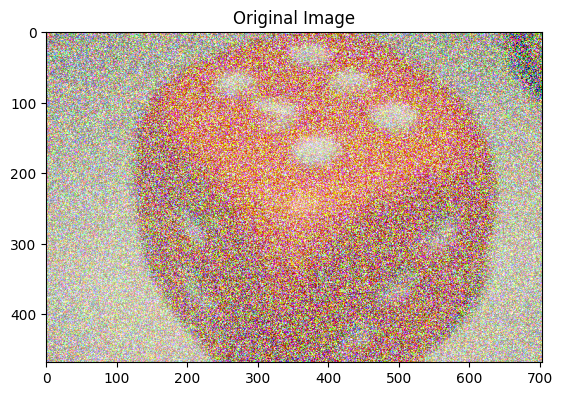

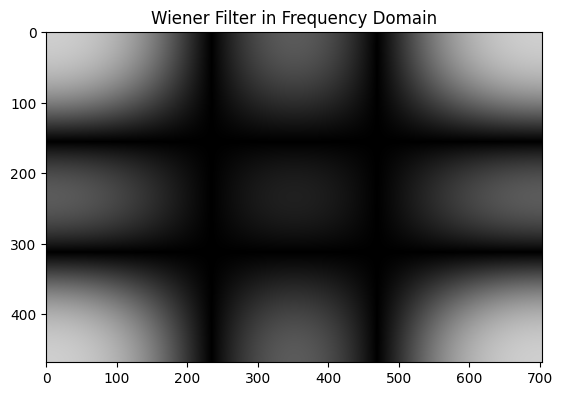

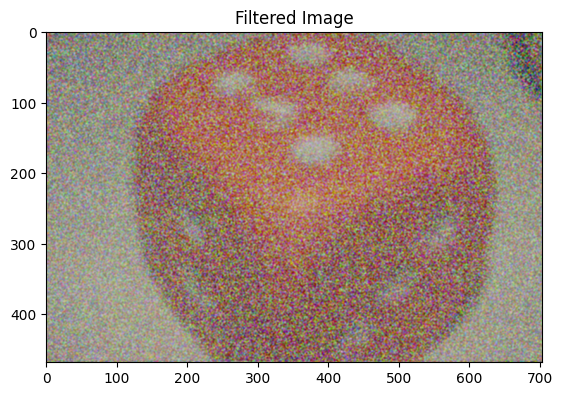

PSNR of the noisy image:  6.608012655397994
PSNR of the filtered image:  12.224561559377236


In [10]:
test_img = cv2.imread('Corrupted_CV2/image3_noise_07_blur_17.png')
kernel = np.ones((3, 3, test_img.shape[2]), dtype=np.float32)/9
K = 0.3

result_img = custom_wiener_filter(image=test_img, kernel=kernel, K=K, show_intermediate=True, show_result=True)

gt_image = cv2.imread('Dataset/image3.png')
print('PSNR of the noisy image: ', peak_signal_noise_ratio(test_img, gt_image))
print('PSNR of the filtered image: ', peak_signal_noise_ratio(gt_image, result_img))


In [11]:
denoised_folder_path = 'Denoised_Results'
corrupted_folder_path = 'Corrupted_CV2'

corrupted_images = os.listdir(corrupted_folder_path)
corrupted_images.sort()

for image in corrupted_images:
    _image_ = cv2.imread(os.path.join(corrupted_folder_path, image))
    _kernel_ = np.ones((3, 3, _image_.shape[2]), dtype=np.float32)/9
    _K_ = 0.3
    _result_ = custom_wiener_filter(image=_image_, kernel=_kernel_, K=_K_)
    cv2.imwrite(os.path.join(denoised_folder_path, image), _result_)
    

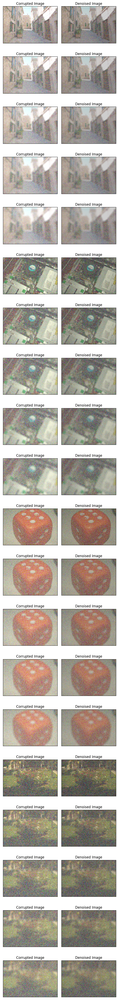

In [12]:
denoised_folder_path = 'Denoised_Results'
corrupted_folder_path = 'Corrupted_CV2'
gt_folder_path = 'Dataset'

corrupted_images = os.listdir(corrupted_folder_path)
corrupted_images.sort()

# create a grid of size 20 x 2 and show the images side by side
fig, axes = plt.subplots(20, 2, figsize=(6, 50))

for i, ax in enumerate(axes.flat):
    if i % 2 == 0:
        image = cv2.imread(os.path.join(corrupted_folder_path, corrupted_images[i//2]))
        ax.set_title('Corrupted Image')
    else:
        image = cv2.imread(os.path.join(denoised_folder_path, corrupted_images[i//2]))
        ax.set_title('Denoised Image')
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    ax.imshow(image)
    ax.set_xticks([])
    ax.set_yticks([])

plt.tight_layout()
plt.show()


Make a comparison report for the denoised images

In [13]:
denoised_folder_path = 'Denoised_Results'
corrupted_folder_path = 'Corrupted_CV2'
gt_folder_path = 'Dataset'

corrupted_images = os.listdir(corrupted_folder_path)
corrupted_images.sort()

denoised_report = []

for image in corrupted_images:
    _gt_ = cv2.imread(os.path.join(gt_folder_path, image.split('_')[0] + '.png'))
    _image_ = cv2.imread(os.path.join(corrupted_folder_path, image))
    _result_ = cv2.imread(os.path.join(denoised_folder_path, image))
    psnr1 = peak_signal_noise_ratio(_gt_, _image_)
    psnr2 = peak_signal_noise_ratio(_gt_, _result_)
    denoised_report.append([image.split('.')[0], psnr1, psnr2])

denoised_report = pd.DataFrame(denoised_report, columns=['Image', 'PSNR of Corrupted Image', 'PSNR of Denoised Image'])
denoised_report.to_csv('denoised_report.csv', index=False)

In [14]:
denoised_report

,Image,PSNR of Corrupted Image,PSNR of Denoised Image
0,image1_noise_03_blur_05,9.040603,15.162193
1,image1_noise_05_blur_11,8.433515,14.113834
2,image1_noise_07_blur_17,8.185878,13.622357
3,image1_noise_09_blur_23,8.032233,13.287484
4,image1_noise_11_blur_29,7.935132,13.053590
5,image2_noise_03_blur_05,6.956838,12.656215
6,image2_noise_05_blur_11,6.361935,11.571034
7,image2_noise_07_blur_17,6.121967,11.077882
8,image2_noise_09_blur_23,5.987457,10.777567
9,image2_noise_11_blur_29,5.892901,10.545413


#### Part 4 : Comparison with other image restoration algorithms

Implementing the following algorithms for comparison

- Non Local Means Denoising : Unlike "local mean" filters, which take the mean value of a group of pixels surrounding a target pixel to smooth the image, non-local means filtering takes a mean of all pixels in the image, weighted by how similar these pixels are to the target pixel. This results in much greater post-filtering clarity, and less loss of detail in the image compared with local mean algorithms.

- Median Filter : The main idea of the median filter is to run through the signal entry by entry, replacing each entry with the median of neighboring entries. The pattern of neighbors is called the "window", which slides, entry by entry, over the entire signal.

- Bilateral Filter : Bilateral Filter replaces the intensity of each pixel with a weighted average of intensity values from nearby pixels. This weight can be based on a Gaussian distribution. Crucially, the weights depend not only on Euclidean distance of pixels, but also on the radiometric differences (e.g., range differences, such as color intensity, depth distance, etc.). This preserves sharp edges.

- Gaussian Filter : A Gaussian filter is a linear filter. It's usually used to blur the image or to reduce noise. Gaussian filter is a low-pass filter, because it attenuates the high-frequency components and passes only the low-frequency components.

- Total Variation Filter : Total variation denoising (TVD) is an image denoising algorithm which is based on the principle that signals with excessive and possibly spurious detail have high total variation, that is, the integral of the absolute gradient of the signal is high. According to this principle, reducing the total variation of the signal subject to it being a close match to the original signal, removes unwanted detail whilst preserving important details such as edges.

In [15]:
# non local mean filter
def non_local_mean_rgb(image, sigma=0.08, patch_size=7, patch_distance=11):
    denoised_image = cv2.fastNlMeansDenoisingColored(image, None, sigma, sigma, patch_size, patch_distance)
    return denoised_image

# median filter
def median_filter_rgb(image, kernel_size=3):
    denoised_image = np.zeros_like(image)
    for i in range(image.shape[2]):
        denoised_image[:, :, i] = cv2.medianBlur(image[:, :, i], kernel_size)
    return denoised_image

# gaussian smoothing filter
def gaussian_smooting_filter_rgb(image, kernel_size=3):
    denoised_image = np.zeros_like(image)
    for i in range(image.shape[2]):
        denoised_image[:, :, i] = cv2.GaussianBlur(image[:, :, i], (kernel_size, kernel_size), 0)
    return denoised_image

# bilateral filter
def bilateral_filter_rgb(image, kernel_size=3):
    denoised_image = np.zeros_like(image)
    for i in range(image.shape[2]):
        denoised_image[:, :, i] = cv2.bilateralFilter(image[:, :, i], kernel_size, 75, 75)
    return denoised_image

# total variation regularization
def total_variation_regularization_rgb(image, weight=0.1, eps=0.0002):
    image = image.astype(np.float32) / 255.0
    denoised_image = np.zeros_like(image)
    for i in range(image.shape[2]):
        denoised_image[:, :, i] = denoise_tv_chambolle(image[:, :, i], weight=weight, eps=eps)
    denoised_image = (denoised_image * 255).astype(np.uint8)
    return denoised_image

In [16]:
# function to compare the filters and plot the results
def compare_filters(original, noisy, denoised):
    
    original_ = cv2.imread(original)
    noisy_ = cv2.imread(noisy)
    denoised_0 = cv2.imread(denoised)
    denoised_1 = non_local_mean_rgb(noisy_)
    denoised_2 = median_filter_rgb(noisy_)
    denoised_3 = gaussian_smooting_filter_rgb(noisy_)
    denoised_4 = bilateral_filter_rgb(noisy_)
    denoised_5 = total_variation_regularization_rgb(noisy_)

    result = {}
    result['Noisy'] = peak_signal_noise_ratio(original_, noisy_)
    result['Wiener Filter'] = peak_signal_noise_ratio(original_, denoised_0)
    result['Non Local Means'] = peak_signal_noise_ratio(original_, denoised_1)
    result['Median Filter'] = peak_signal_noise_ratio(original_, denoised_2)
    result['Gaussian Smoothing'] = peak_signal_noise_ratio(original_, denoised_3)
    result['Bilateral Filter'] = peak_signal_noise_ratio(original_, denoised_4)
    result['Total Variation Regularization'] = peak_signal_noise_ratio(original_, denoised_5)

    fig, axes = plt.subplots(2, 4, figsize=(15, 6))

    axes[0, 0].imshow(cv2.cvtColor(original_, cv2.COLOR_BGR2RGB))
    axes[0, 0].set_title('Original Image')
    axes[0, 0].axis('off')

    axes[0, 1].imshow(cv2.cvtColor(noisy_, cv2.COLOR_BGR2RGB))
    axes[0, 1].set_title('Noisy Image')
    axes[0, 1].axis('off')

    axes[0, 2].imshow(cv2.cvtColor(denoised_0, cv2.COLOR_BGR2RGB))
    axes[0, 2].set_title('Wiener Filter')
    axes[0, 2].axis('off')

    axes[0, 3].imshow(cv2.cvtColor(denoised_1, cv2.COLOR_BGR2RGB))
    axes[0, 3].set_title('Non Local Means')
    axes[0, 3].axis('off')

    axes[1, 0].imshow(cv2.cvtColor(denoised_2, cv2.COLOR_BGR2RGB))
    axes[1, 0].set_title('Median Filter')
    axes[1, 0].axis('off')

    axes[1, 1].imshow(cv2.cvtColor(denoised_3, cv2.COLOR_BGR2RGB))
    axes[1, 1].set_title('Gaussian Smoothing')
    axes[1, 1].axis('off')

    axes[1, 2].imshow(cv2.cvtColor(denoised_4, cv2.COLOR_BGR2RGB))
    axes[1, 2].set_title('Bilateral Filter')
    axes[1, 2].axis('off')

    axes[1, 3].imshow(cv2.cvtColor(denoised_5, cv2.COLOR_BGR2RGB))
    axes[1, 3].set_title('Total Variation Regularization')
    axes[1, 3].axis('off')

    plt.tight_layout()
    plt.show()

    return result

Image 1

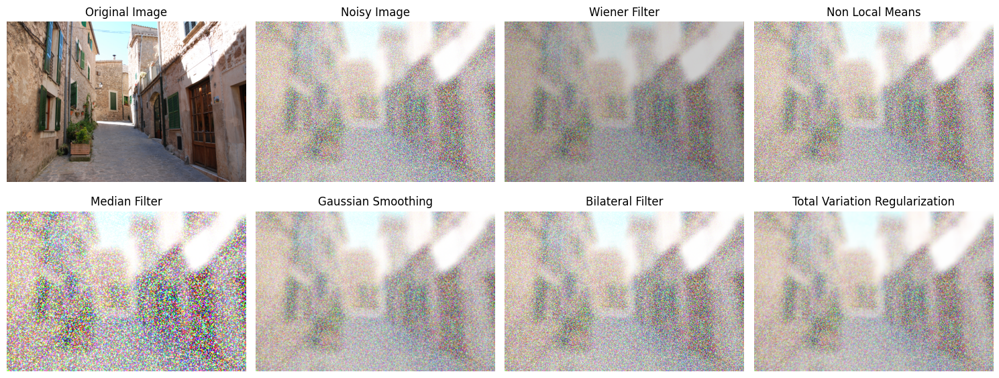

Comparison Results


,PSNR
Noisy,7.935132
Wiener Filter,13.053590
Non Local Means,7.993497
Median Filter,8.381787
Gaussian Smoothing,10.024630
Bilateral Filter,8.623257
Total Variation Regularization,9.758347


In [17]:
results_1 = compare_filters('Dataset/image1.png', 
                            'Corrupted_CV2/image1_noise_11_blur_29.png', 
                            'Denoised_Results/image1_noise_11_blur_29.png')
print('Comparison Results')
df_1 = pd.DataFrame(results_1, index=['PSNR']).T
df_1

Image 2

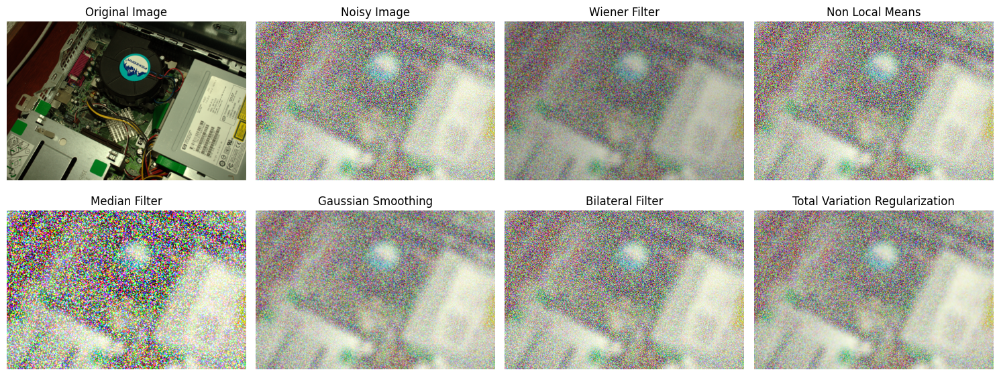

Comparison Results


,PSNR
Noisy,5.892901
Wiener Filter,10.545413
Non Local Means,5.938721
Median Filter,6.378402
Gaussian Smoothing,8.095650
Bilateral Filter,6.234894
Total Variation Regularization,7.526716


In [18]:
results_2 = compare_filters('Dataset/image2.png', 
                            'Corrupted_CV2/image2_noise_11_blur_29.png', 
                            'Denoised_Results/image2_noise_11_blur_29.png')
print('Comparison Results')
df_2 = pd.DataFrame(results_2, index=['PSNR']).T
df_2

Image 3

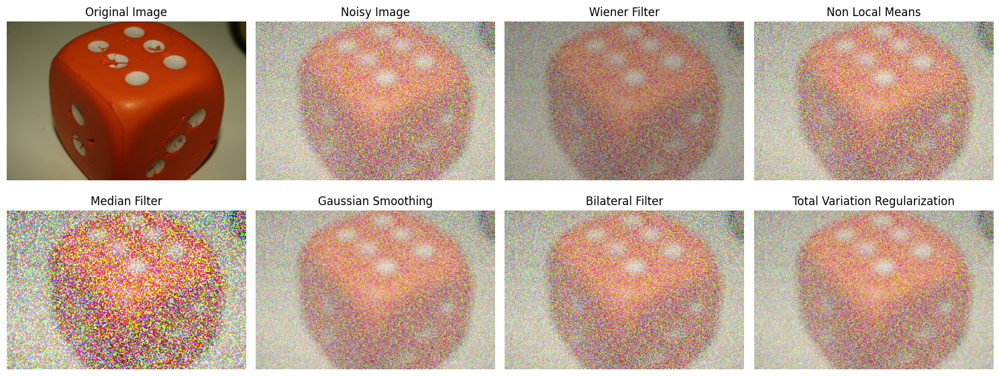

Comparison Results


,PSNR
Noisy,6.410956
Wiener Filter,11.738220
Non Local Means,6.458596
Median Filter,6.937527
Gaussian Smoothing,8.760057
Bilateral Filter,6.857594
Total Variation Regularization,8.199067


In [19]:
results_3 = compare_filters('Dataset/image3.png',
                            'Corrupted_CV2/image3_noise_11_blur_29.png',
                            'Denoised_Results/image3_noise_11_blur_29.png')
print('Comparison Results')
df_3 = pd.DataFrame(results_3, index=['PSNR']).T
df_3

Image 4

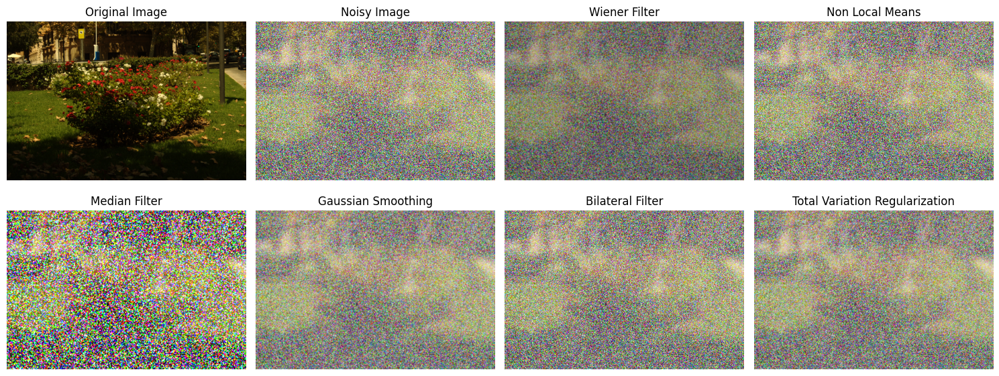

Comparison Results


,PSNR
Noisy,4.558332
Wiener Filter,9.078822
Non Local Means,4.594948
Median Filter,5.114527
Gaussian Smoothing,6.892846
Bilateral Filter,4.756240
Total Variation Regularization,6.139856


In [20]:
results_4 = compare_filters('Dataset/image4.png',
                            'Corrupted_CV2/image4_noise_11_blur_29.png',
                            'Denoised_Results/image4_noise_11_blur_29.png')
print('Comparison Results')
df_4 = pd.DataFrame(results_4, index=['PSNR']).T
df_4

Visualizing the results

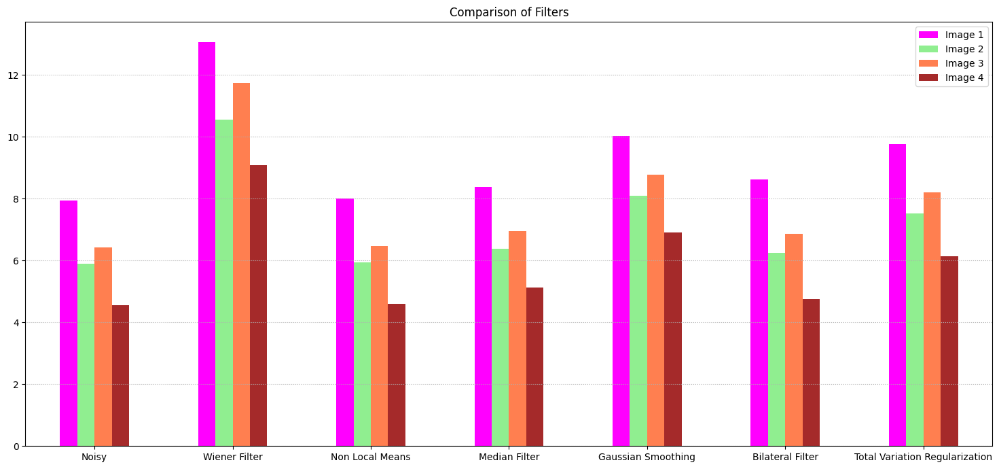

In [60]:
combined_df = pd.concat([df_1, df_2, df_3, df_4], axis=1)
fig, ax = plt.subplots(figsize=(15, 7))
combined_df.plot.bar(ax=ax, rot=0, color=['magenta', 'lightgreen', 'coral', 'brown'])
ax.set_title('Comparison of Filters')
ax.legend(['Image 1', 'Image 2', 'Image 3', 'Image 4'])
plt.tight_layout()
plt.grid(axis='y', linestyle='dotted')
plt.show()


Inference : Wiener Filter outperforms all the other filters in terms of PSNR.

#### References

- Weiner Filter (Wikipedia) : https://en.wikipedia.org/wiki/Wiener_filter
- Weiner Filter (Mathworks) : https://www.mathworks.com/help/images/ref/wiener2.html
- Weiner Filter (Scipy) : https://docs.scipy.org/doc/scipy/reference/generated/scipy.signal.wiener.html
- Non Local Means Denoising (Wikipedia) : https://en.wikipedia.org/wiki/Non-local_means
- Bilateral Filter (Wikipedia) : https://en.wikipedia.org/wiki/Bilateral_filter
- Gaussian Filter (Wikipedia) : https://en.wikipedia.org/wiki/Gaussian_filter
- Total Variation Filter (Wikipedia) : https://en.wikipedia.org/wiki/Total_variation_denoising
- Median Filter (Wikipedia) : https://en.wikipedia.org/wiki/Median_filter
- Image Filtering with Wiener Filter and Median Filter, DOI-10.13140/RG.2.2.15700.65921